In [54]:
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import pandas as pd
import pandas_datareader.data as web




from datetime import date
from matplotlib import style
from mpl_finance import candlestick_ohlc
from nsepy.history import get_history

style.use('ggplot')

In [45]:
# Get the date interval for stocks to investigate.
start=date(2019,5,1)
end=date(2019,11,7)

In [46]:
sbin = get_history(symbol='SBIN', start=start, end=end)

In [47]:
df = web.DataReader('AAPL', 'yahoo',  start=start, end=end)

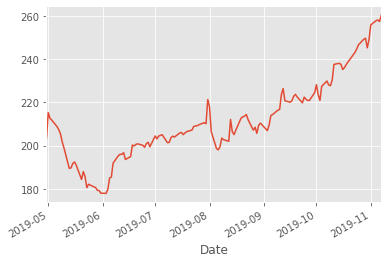

In [48]:
df['High'].plot()

In [49]:
# Let's get moving average.
df['100ma'] = df['Adj Close'].rolling(window=100, min_periods=0).mean()

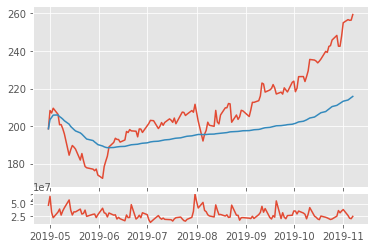

In [50]:
# Now let's graph the data out.
ax1 = plt.subplot2grid((6,1), (0,0), rowspan=5, colspan=1)
ax2 = plt.subplot2grid((6,1), (5,0), rowspan=5, colspan=1)
ax1.plot(df.index, df['Adj Close'])
ax1.plot(df.index, df['100ma'])
ax2.plot(df.index, df['Volume'])

plt.show()

In [51]:
'''
Let's visit sampling of the data
'''

df_ohlc = df['Adj Close'].resample('10D').ohlc()

In [55]:
df_ohlc.reset_index(inplace=True)

In [53]:
df_volume  = df['Volume'].resample('10D').sum()

In [56]:
df_ohlc['Date']= df_ohlc['Date'].map(mdates.date2num)

In [57]:
df_ohlc.head()

,Date,open,high,low,close
0,737179.0,198.547455,209.510269,198.547455,198.596924
1,737189.0,195.845673,195.845673,184.463242,187.721039
2,737199.0,181.851028,185.337280,176.179657,176.179657
3,737209.0,177.093445,188.863251,172.127274,188.863251
4,737219.0,191.276810,197.107086,191.276810,197.107086


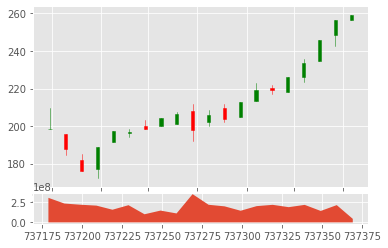

In [61]:
ax3 = plt.subplot2grid((6,1), (0,0), rowspan=5, colspan=1)
ax4 = plt.subplot2grid((6,1), (5,0), rowspan=5, colspan=1)
ax3.xaxis_date()
candlestick_ohlc(ax3, df_ohlc.values, width=2, colorup='g')
ax4.fill_between(df_volume.index.map(mdates.date2num), df_volume.values, 0)

In [1]:
import numpy as np

In [2]:
import math

In [7]:
a = np.array([[1,2,3], [4,5,6]])

In [8]:
a

array([[1, 2, 3],
       [4, 5, 6]])

In [10]:
print(a.shape)

(2, 3)


In [15]:
np.random.rand(2,3)

array([[0.03823406, 0.97255752, 0.95593285],
       [0.70139669, 0.05441759, 0.31055471]])

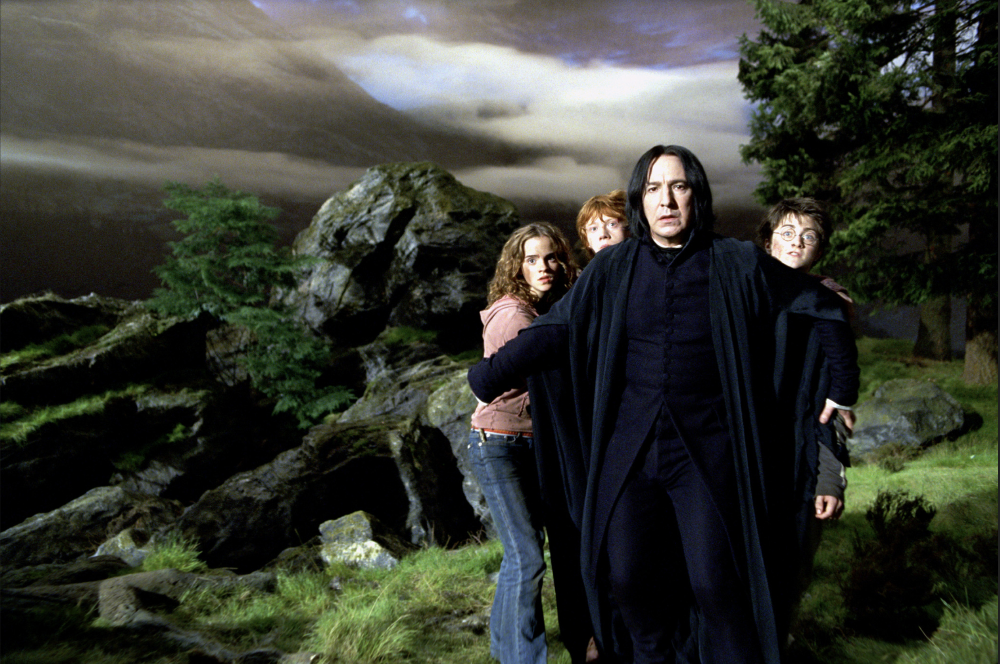

In [44]:
from PIL import Image
from IPython.display import display

# And let's just look at the image I'm talking about
im = Image.open('/Users/anujsingh/Desktop/Screenshot 2021-08-20 at 11.14.43 PM.png')
display(im)

In [45]:
# Now, we can conver this PIL image to a numpy array
array=np.array(im)
print(array.shape)
array

(1682, 2532, 4)


array([[[ 28,  28,  28, 255],
        [ 87,  85,  89, 255],
        [ 88,  86,  96, 255],
        ...,
        [ 28,  28,  28, 255],
        [ 28,  28,  28, 255],
        [ 28,  28,  28, 255]],

       [[ 28,  28,  28, 255],
        [ 91,  88,  93, 255],
        [ 92,  88, 100, 255],
        ...,
        [ 28,  28,  28, 255],
        [ 28,  28,  28, 255],
        [ 28,  28,  28, 255]],

       [[ 28,  28,  28, 255],
        [ 93,  92,  98, 255],
        [ 93,  91, 101, 255],
        ...,
        [ 28,  28,  28, 255],
        [ 28,  28,  28, 255],
        [ 28,  28,  28, 255]],

       ...,

       [[ 31,  31,  31, 255],
        [ 15,  21,   5, 255],
        [ 14,  19,   6, 255],
        ...,
        [ 31,  31,  31, 255],
        [ 31,  31,  31, 255],
        [ 31,  31,  31, 255]],

       [[ 31,  31,  31, 255],
        [ 14,  19,   3, 255],
        [ 12,  17,   5, 255],
        ...,
        [ 31,  31,  31, 255],
        [ 31,  31,  31, 255],
        [ 31,  31,  31, 255]],

       [[ 31

In [46]:
mask=np.full(array.shape,255)
mask

array([[[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255]],

       [[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255]],

       [[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255]],

       ...,

       [[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255]],

       [[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255]],

       [[255

In [47]:
# Now let's subtract that from the modified array
modified_array=array-mask

# And lets convert all of the negative values to positive values
modified_array=modified_array*-1

# And as a last step, let's tell numpy to set the value of the datatype correctly
modified_array=modified_array.astype(np.uint8)
modified_array

array([[[227, 227, 227,   0],
        [168, 170, 166,   0],
        [167, 169, 159,   0],
        ...,
        [227, 227, 227,   0],
        [227, 227, 227,   0],
        [227, 227, 227,   0]],

       [[227, 227, 227,   0],
        [164, 167, 162,   0],
        [163, 167, 155,   0],
        ...,
        [227, 227, 227,   0],
        [227, 227, 227,   0],
        [227, 227, 227,   0]],

       [[227, 227, 227,   0],
        [162, 163, 157,   0],
        [162, 164, 154,   0],
        ...,
        [227, 227, 227,   0],
        [227, 227, 227,   0],
        [227, 227, 227,   0]],

       ...,

       [[224, 224, 224,   0],
        [240, 234, 250,   0],
        [241, 236, 249,   0],
        ...,
        [224, 224, 224,   0],
        [224, 224, 224,   0],
        [224, 224, 224,   0]],

       [[224, 224, 224,   0],
        [241, 236, 252,   0],
        [243, 238, 250,   0],
        ...,
        [224, 224, 224,   0],
        [224, 224, 224,   0],
        [224, 224, 224,   0]],

       [[224

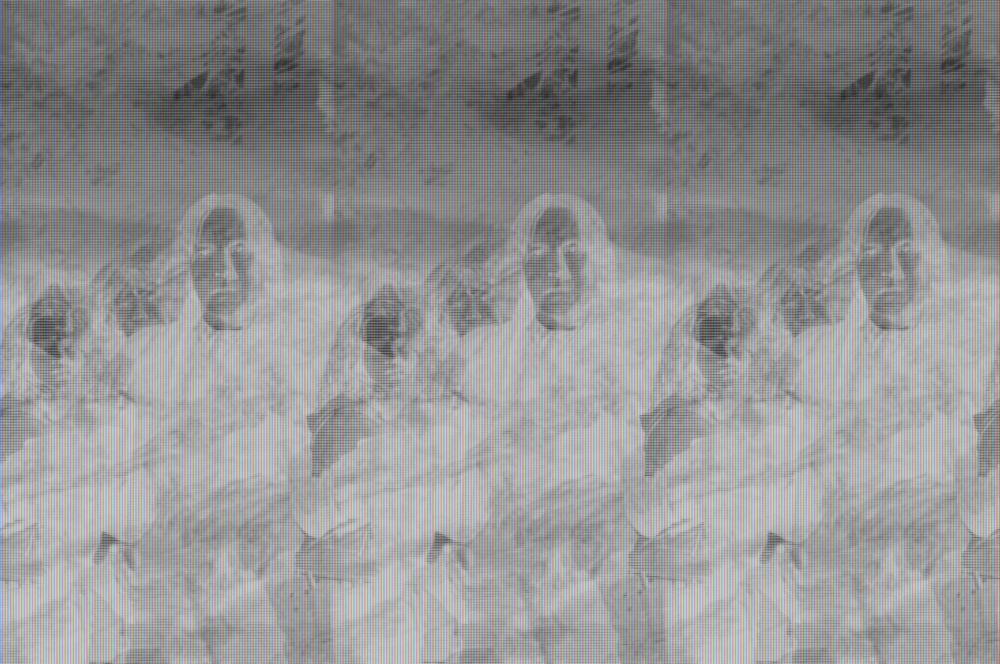

In [43]:
display(Image.fromarray(modified_array, "RGB"))

In [1]:
import re

In [28]:
text = "Mehnaz. Mehnaz is a female. Mehnaz is kind. Mehnaz is protective. Mehnaz cooks chicken."

In [29]:
re.split("Mehnaz", text)

['',
 '. ',
 ' is a female. ',
 ' is kind. ',
 ' is protective. ',
 ' cooks chicken.']

In [30]:
re.match("Mehnaz", text)

<re.Match object; span=(0, 6), match='Mehnaz'>

In [31]:
re.findall("Mehnaz", text)

['Mehnaz', 'Mehnaz', 'Mehnaz', 'Mehnaz', 'Mehnaz']